<a href="https://colab.research.google.com/github/soniadas123/BBMP-Tree-Census-2025/blob/main/updated1_final2025_Bengaluru_tree_census.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Tree Census Bengaluru 2025.
Data downloaded from OpenCity https://data.opencity.in/dataset/bengaluru-tree-census-data

I have analysed the ongoing Tree Census in Bengaluru. The code was written in February 2025. As and when data is added I will update the code.


Happy Coding, be curious :)

In [1]:

from google.colab import drive
drive.mount('/content/drive')

!pip install geopandas



import os
import geopandas as gpd

# Step 4: Define the path to your folder
folder_path = '/content/drive/My Drive/2025_bengaluru_treecensus' #give the path where data is saved

# Step 5: List all KML files in the folder
kml_files = [f for f in os.listdir(folder_path) if f.endswith('.kml')]

# Step 6: Load each KML file into a GeoDataFrame
for kml_file in kml_files:
    file_path = os.path.join(folder_path, kml_file)
    gdf = gpd.read_file(file_path)
    print(f"Loaded {kml_file} with {len(gdf)} features")

Mounted at /content/drive
Loaded bbmp_tree_census_yelahanka_jan_2025.kml with 10529 features
Loaded bbmp_tree_census_west_jan_2025.kml with 19855 features
Loaded bbmp_tree_census_mahadevapura_jan_2025.kml with 48279 features
Loaded bbmp_tree_census_east_jan_2025.kml with 52227 features
Loaded bbmp_tree_census_south_jan_2025.kml with 72456 features
Loaded bbmp_tree_census_bommanahalli_jan_2025.kml with 103385 features
Loaded bbmp_tree_census_rr_nagar_jan_2025.kml with 110157 features


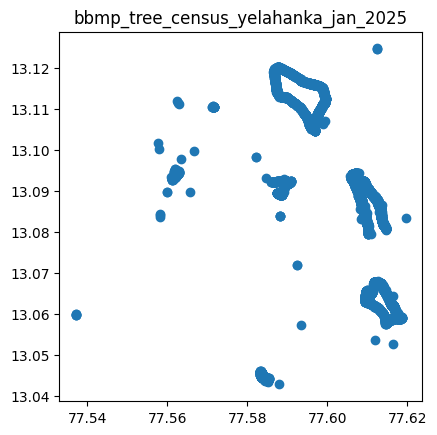

In [2]:
#this is just to check one kml

import pandas as pd
import matplotlib.pyplot as plt



file_path = os.path.join(folder_path, 'bbmp_tree_census_yelahanka_jan_2025.kml')
gdf = gpd.read_file(file_path)

# Plot the GeoDataFrame
gdf.plot()
plt.title('bbmp_tree_census_yelahanka_jan_2025')
plt.show()

In [3]:
# while loading kml certain columns were missing. Hence i merged all 7 kml in QGIS. saved as a geopackage and uploaded it to drive

import pandas as pd
import geopandas as gpd

file_path = '/content/drive/My Drive/2025_bengaluru_treecensus/merged_tree_2025.gpkg'
gdf_allzones = gpd.read_file(file_path)

# Now you can work with the geopandas GeoDataFrame 'gdf'
print(gdf_allzones.head())

   Name description timestamp begin end altitudeMode  tessellate  extrude  \
0  None        None       NaT   NaT NaT         None          -1        0   
1  None        None       NaT   NaT NaT         None          -1        0   
2  None        None       NaT   NaT NaT         None          -1        0   
3  None        None       NaT   NaT NaT         None          -1        0   
4  None        None       NaT   NaT NaT         None          -1        0   

   visibility  drawOrder  ... OBJECTID                              TreeName  \
0          -1        NaN  ...     5786   Khaya Senegalensis (Desr.) A. Juss.   
1          -1        NaN  ...     5791  Acacia Auriculiformis Cunn. Ex Benth   
2          -1        NaN  ...     5796  Acacia Auriculiformis Cunn. Ex Benth   
3          -1        NaN  ...     5798  Acacia Auriculiformis Cunn. Ex Benth   
4          -1        NaN  ...     5799      Wrightia Tinctoria (Roxb.) R. Br   

        KGISTreeID DepartmentCode                       

In [4]:
# prompt: convert geopackage to shapefile

# Assuming 'gdf_allzones' is your GeoDataFrame loaded from the geopackage

output_shapefile_path = '/content/drive/My Drive/2025_bengaluru_treecensus/merged_tree_2025.shp'  # Specify the desired output path for the shapefile

gdf_allzones.to_file(output_shapefile_path)

print(f"Shapefile created at: {output_shapefile_path}")


<ipython-input-4-0944452317c2>:7: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf_allzones.to_file(output_shapefile_path)


Shapefile created at: /content/drive/My Drive/2025_bengaluru_treecensus/merged_tree_2025.shp


/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'description' to 'descriptio'
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field timestamp create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field begin create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field end create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'altitudeMode' to 'altitudeMo'
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'DepartmentCode' to 'Department'
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/l

In [5]:
# prompt: gdf_allzones all points . print no of points. give number in lakhs use comma

num_points = len(gdf_allzones)
print(f'{num_points/100000:,.2f} Lakhs')


4.17 Lakhs


In [6]:

print(gdf_allzones.crs)

EPSG:4326


In [7]:
# prompt: how many unique values are in column TreeName. The no of species

# Assuming 'gdf' is your GeoDataFrame
unique_species_count = gdf_allzones['TreeName'].nunique()
print(f"Number of unique tree species: {unique_species_count}")

Number of unique tree species: 234


We will ignore others. Total species will be **233**

In [8]:
# prompt: write a code that will group species with same name and create a table

# Group by 'TreeName' and count occurrences
species_counts = gdf_allzones.groupby('TreeName').size().reset_index(name='Count')

# Sort the table by count in descending order
species_counts = species_counts.sort_values(by='Count', ascending=False)

# Display the table
species_counts

,TreeName,Count
153,Others,160463
173,Pongamia Pinnata (L.) Pierre,72725
200,Swietenia Mahagoni (L.) Jacq.,16622
212,Tabebuia Rosea (Bertol) Dc.,10351
189,Saraca Asoca (Roxb.) De Wilde,8655
...,...,...
123,Limonia Acidissima L.,3
87,Eriobotrya Japonica (Thunb.) Lindley,2
39,Brownea Coccinea Jacq.,2
217,Tecoma Castanifolia (D. Don) Melch,2


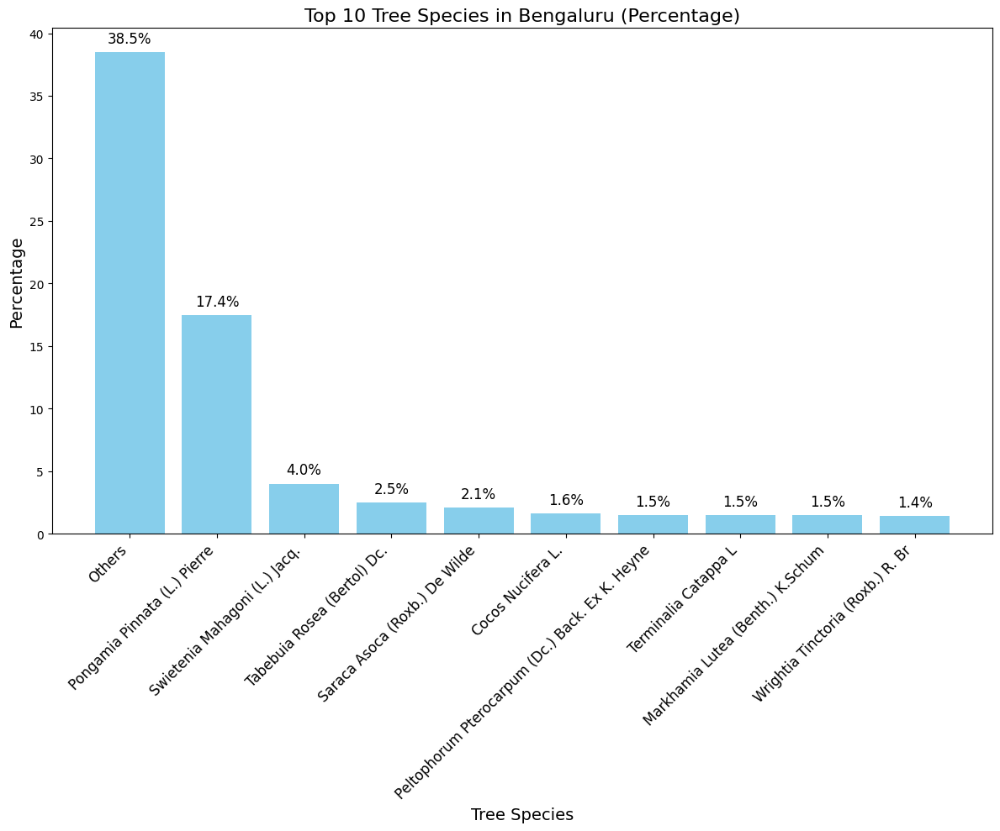

In [9]:


import matplotlib.pyplot as plt

total_trees = species_counts['Count'].sum()
species_counts['Percentage'] = (species_counts['Count'] / total_trees) * 100

#  top 10 species
top_10_species = species_counts.head(10)

#  bar chart
plt.figure(figsize=(12, 10))  # Increased figure size for better readability
bars = plt.bar(top_10_species['TreeName'], top_10_species['Percentage'], color='skyblue')
plt.xlabel("Tree Species", fontsize=14) # Increased font size
plt.ylabel("Percentage", fontsize=14) # Increased font size
plt.title("Top 10 Tree Species in Bengaluru (Percentage)", fontsize=16) # Increased font size
plt.xticks(rotation=45, ha='right', fontsize=12) # Increased font size and rotated labels
plt.tight_layout()

# Add percentage labels on top of each bar
for bar, percentage in zip(bars, top_10_species['Percentage']):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, f'{percentage:.1f}%', ha='center', va='bottom', fontsize=12) # Increased font size
plt.savefig('/content/top_10_tree_species.png', dpi=300, bbox_inches='tight')
plt.show()

Other that has 38 percent is not really species. So we will ignore that.

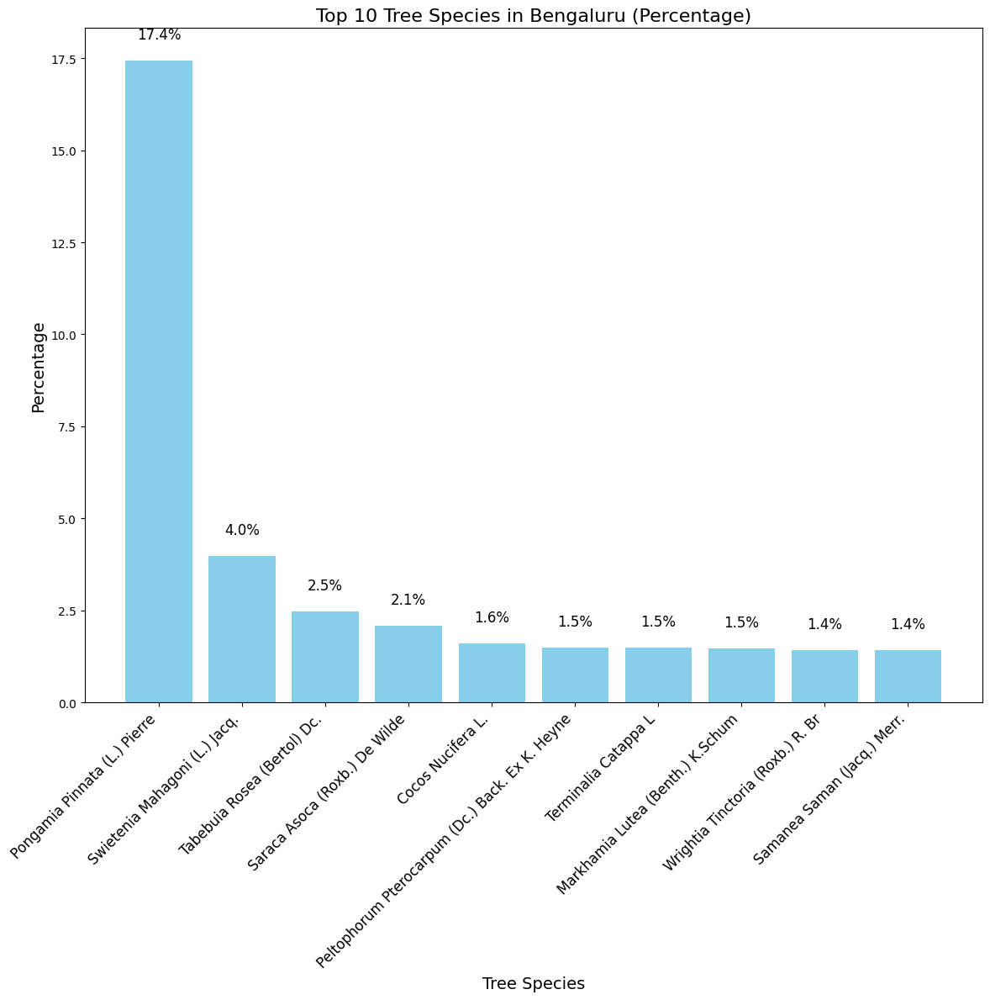

In [10]:


import matplotlib.pyplot as plt


# Calculate the total number of trees
total_trees = species_counts['Count'].sum()

# Calculate the percentage of each species
species_counts['Percentage'] = (species_counts['Count'] / total_trees) * 100

# Sort by percentage in descending order
species_counts = species_counts.sort_values(by='Percentage', ascending=False)

# Get the top 10 species (excluding the highest percentage)
top_10_species = species_counts[1:11]  # Slice from index 1 (second element) to 11 (exclusive)

# Create the bar chart for the top 10 species
plt.figure(figsize=(12, 12))
bars = plt.bar(top_10_species['TreeName'], top_10_species['Percentage'], color='skyblue')
plt.xlabel("Tree Species", fontsize=14)
plt.ylabel("Percentage", fontsize=14)
plt.title("Top 10 Tree Species in Bengaluru (Percentage)", fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.tight_layout()

# Add percentage labels on top of each bar
for bar, percentage in zip(bars, top_10_species['Percentage']):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, f'{percentage:.1f}%', ha='center', va='bottom', fontsize=12)
plt.savefig('/content/final_top_10_tree_species.png', dpi=300, bbox_inches='tight')
plt.show()

In [11]:

top_10_species = species_counts.head(10)

# Print the list of top 10 species
print(top_10_species['TreeName'].tolist())

['Others', 'Pongamia Pinnata (L.) Pierre', 'Swietenia Mahagoni (L.) Jacq.', 'Tabebuia Rosea (Bertol) Dc.', 'Saraca Asoca (Roxb.) De Wilde', 'Cocos Nucifera L.', 'Peltophorum Pterocarpum (Dc.) Back. Ex K. Heyne', 'Terminalia Catappa L', 'Markhamia Lutea (Benth.) K.Schum', 'Wrightia Tinctoria (Roxb.) R. Br']


 I want to see the distribution of Tabebuia Rosea. The tree that gives Bengaluru pink colours.

In [12]:
#

# Filter the GeoDataFrame for 'Tabebuia Rosea (Bertol) Dc.'
tabebuia_rosea_gdf = gdf_allzones[gdf_allzones['TreeName'] == 'Tabebuia Rosea (Bertol) Dc.']

# Export the filtered GeoDataFrame to a new GeoPackage file
output_file = '/content/drive/My Drive/2025_bengaluru_treecensus/tabebuia_rosea.gpkg'
tabebuia_rosea_gdf.to_file(output_file, driver='GPKG')

print(f"GeoPackage file created: {output_file}")

GeoPackage file created: /content/drive/My Drive/2025_bengaluru_treecensus/tabebuia_rosea.gpkg


In [13]:
#  print count of tabebuia_rosea_gdf. The tree that gives Bengaluru pink colour.

print(len(tabebuia_rosea_gdf))

10351


In [14]:
#use matplotlib and folium to plot tabebuia_rosea. use a red marker . put title as Distribution of Tabebuia Rosea in Bengaluru.

import folium

# Assuming tabebuia_rosea_gdf is already created as in the previous code

# Create a map centered around Bengaluru
m = folium.Map(location=[12.9716, 77.5946], zoom_start=10)

# Add markers for each Tabebuia Rosea tree
for index, row in tabebuia_rosea_gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=row['TreeName'],  # Optional: Add tree name as popup
        icon=folium.Icon(color='red')
    ).add_to(m)

# Set the map title
m.title = 'Distribution of Tabebuia Rosea in Bengaluru'

# Display the map
m

In [15]:
pip install contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 48.8 MB/s eta 0:00:00


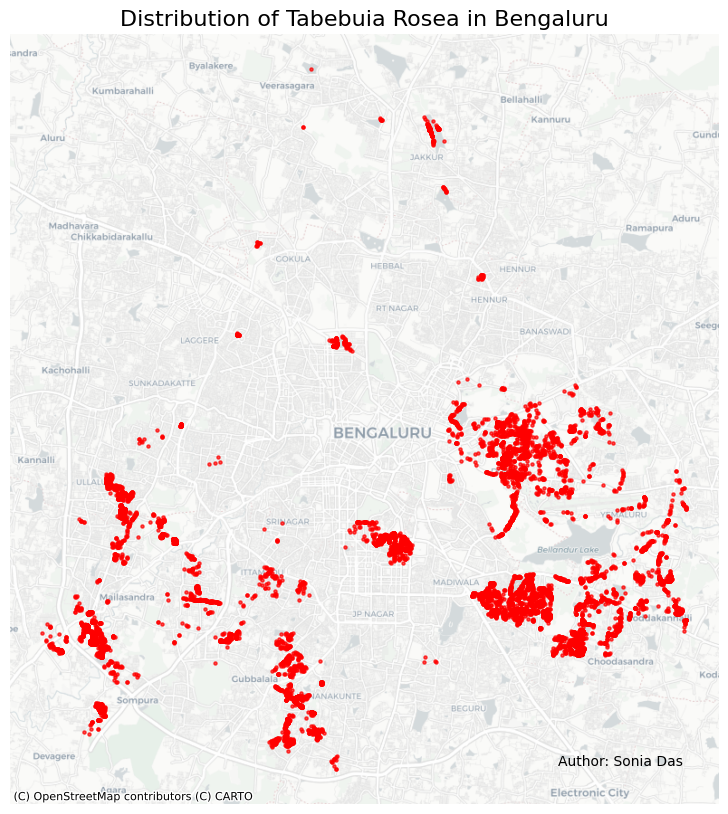

In [16]:


import contextily as ctx
import matplotlib.pyplot as plt

# Assuming tabebuia_rosea_gdf is your GeoDataFrame for Tabebuia Rosea

# Create the plot
fig, ax = plt.subplots(figsize=(10, 10))  # Adjust figure size as needed
tabebuia_rosea_gdf.to_crs(epsg=3857).plot(ax=ax, markersize=5, color='red', alpha=0.7)  # Use appropriate markersize

# Add CartoDB basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)  # You can explore other basemaps

# Remove axis
ax.set_axis_off()

# Add title
plt.title("Distribution of Tabebuia Rosea in Bengaluru", fontsize=16)

# Add author text in the corner
plt.text(0.95, 0.05, "Author: Sonia Das", transform=ax.transAxes, ha='right', fontsize=10)

# Show plot
plt.show()

In [17]:
!pip install folium geopandas shapely

import folium
import geopandas as gpd
from shapely.geometry import Point, shape
from folium.plugins import Draw
from google.colab import output

# Load your GeoDataFrame (Ensure it's pre-loaded)
# tabebuia_rosea_gdf = gpd.read_file("path_to_your_shapefile_or_geojson")

# Function to create a folium map with Leaflet Draw
def create_map():
    m = folium.Map(location=[12.9716, 77.5946], zoom_start=12)

    # Add points
    for _, row in tabebuia_rosea_gdf.iterrows():
        folium.CircleMarker(
            location=[row.geometry.y, row.geometry.x],
            radius=4,
            color="red",
            fill=True,
            fill_color="red",
            fill_opacity=0.5
        ).add_to(m)

    # Add drawing tool
    draw = Draw(
        export=True,  # Allows user to export the drawn shape
        draw_options={"circle": True, "polygon": True, "rectangle": True},
        edit_options={"remove": True}
    )
    draw.add_to(m)

    return m

# Display the interactive map
m = create_map()
display(m)